<div style="text-align: right"> <b>Last Updated:</b> 2JUNE2020 </div>

# Plotting

__Author:__ Natasha A Sahr, PhD

Data visualization is the discipline of trying to understand data by using graphic context so patterns, trends, and correlations that might not otherwise be detected can be exposed.

Data visualization is an important tool to understand data.

Charts, plots, graphs, and maps (and many more) are all types of data visualizations. 

There are many facets involved in data visualization; this tutorial is just the introduction in your python plotting journey. By the end of this introduction, you will have mastered:

- plot basics and how to read a graph
- data transformation
- a normal vs. not normal distribution
- misleading graphs

## Plot Basics

In python, there are many options for visualizing data and is often challenging to choose which library to use. The most common libraries used for plotting include:

- <a href="https://altair-viz.github.io" target="_top">`altair`</a>
- <a href="https://docs.bokeh.org/en/latest/" target="_top">`bokeh`</a>
- <a href="http://ggplot.yhathq.com" target="_top">`ggplot`</a>
- <a href="https://matplotlib.org" target="_top">`matplotlib`</a>
- <a href="https://pandas.pydata.org" target="_top">`pandas`</a>
- <a href="https://plotly.com" target="_top">`plotly`</a>
- <a href="http://www.pygal.org/en/stable/" target="_top">`pygal`</a>
- <a href="http://seaborn.pydata.org" target="_top">`seaborn`</a>

The documentation for each library can be found in the links above. 

For the purpose of this tutorial, we will focus on understanding, programming, and interpreting plots from `plotly`.

### <tt>plotly</tt>

`plotly` is an online tool for visualization. It has a robust API, including one for python. Versions of `plotly`  $< 4$ are online. Versions of `plotly`  $\geq 4$ are offline, and the online functionality has been moved to the `chart-studio` library. 

To use <tt>plotly</tt>, import `plotly` as `plt`.

In [1]:
import plotly as plt

We will cover plotting and reading the following data visualizations in `plotly`:

- scatter plots 
- line graphs
- bar charts
- box plots
- plots for distributions (histograms and density plots)

We will specifically use the `plotly.express` library for quick and easy plotting. 

Keep in mind: some of the same plots can be done `plotly.graph_objs` and `plotly.figure_factory`. These libraries also allow for additional (and more complicated) plots or have additional flexibility. 

### Scatter Plots

To start to evaluate data, we need data. The `iris.csv` dataset contains 5 variables:

- `SepalLength`: the sepal length (cm)
- `SepalWidth`: the sepal width (cm)
- `PetalLength`: the petal length (cm)
- `PetalWidth`: the petal width (cm)
- `Species`: the flower species (cm)

Import `pandas` as `pd`. Use the function `read_csv` in `pandas` to read in the `iris.csv` dataset and name it `dta_iris`. 

__Note__: The variable names are not found in the file and the file does not have an index.

In [2]:
import pandas as pd

dta_iris = pd.read_csv("datasets/iris.csv", 
                       header=None,
                       names=['SepalLength',
                              'SepalWidth',
                              'PetalLength',
                              'PetalWidth',
                              'Species'])

Take a closer look at `dta_iris` by printing out the first 5 rows using the function `head`.

In [3]:
dta_iris.head(5)

,SepalLength,SepalWidth,PetalLength,PetalWidth,Species
0,sepal_length,sepal_width,petal_length,petal_width,species
1,5.1,3.5,1.4,0.2,setosa
2,4.9,3.0,1.4,0.2,setosa
3,4.7,3.2,1.3,0.2,setosa
4,4.6,3.1,1.5,0.2,setosa


Import `plotly.express` as `px` to use the `scatter` function.

In [4]:
import plotly.express as px

A simple scatter plot in `plotly.express` has three arguments:

- the dataset
- the x (also called the independent) variable, identified by the column name from the dataset in quotes
- the y (also called the dependent) variable, identified by the column name from the dataset in quotes


If we want to evaluate the relationship of sepal width on sepal length, we will have the following arguments:

- `dta_iris`
- `x="SepalWidth"`
- `y="SepalLength"`

Use the function `scatter` in `plotly.express` and the three arguments to create a scatterplot figure names `fig_iris`. 

In [5]:
fig_iris = px.scatter(dta_iris, x="SepalWidth", y="SepalLength")

It did not display! Why? Use the fuction `show` to display the scatter plot of the relationship between sepal width and sepal length.

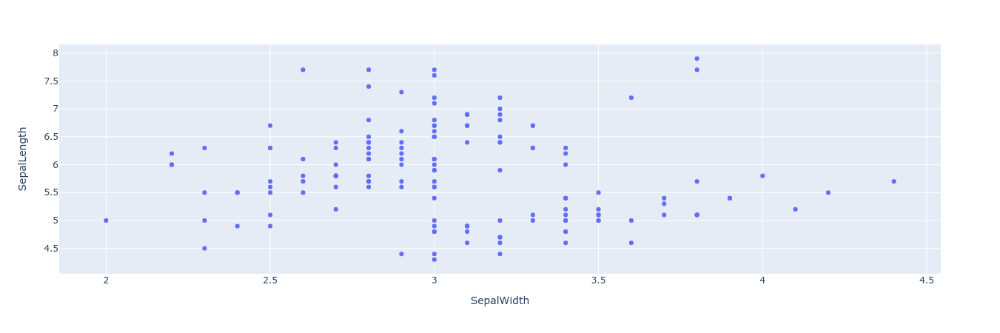

In [6]:
fig_iris.show()

Our first plot! Basic, but provides an initial visualization to evaluate our question: is there are relationship between sepal width and sepal length?

We can see the plot has some interactive features displayed in the top right corner. These tools may be useful but the topic is tabled for later discussion. 

Without these tools, we are still interested in improving the visualization. But how? We can improve these visualizations with <b>better display of the graphic</b> or <b>deeper evaluation of the pattern</b>.

#### better display of the graphic

A better display of the graphic includes changing:
    
- the title  

`title = "Your Title"`
- the labels  

`labels = {'XVar':'Label for XVar','XVar':'Label for XVar'}`
- the template from options `plotly`, `plotly_white`, `plotly_dark`, `ggplot2`, `seaborn`, `simple_white`, and `none`

`template = "Your Template"` 
- the color scheme from color options <a href="https://plotly.com/python/discrete-color/#color-sequences-in-plotly-express" target="_top">here</a>

`color_discrete_sequence=px.colors.qualitative.YOUR_SCHEME`
- and others

See the documentation of the possible arguments for <a href="https://plotly.com/python-api-reference/generated/plotly.express.scatter.html" target="_top">`scatter`</a> in `plotly`.

Create a new figure by improving the display of the graphic called `fig_iris_better`. Update the x and y axis labels to Sepal Width (cm) and Sepal Length (cm), respectively. Change the template to `"simple_white"` and the color scheme to `"Antique"`. Show the figure and evaluate the difference between this figure and your previous version.

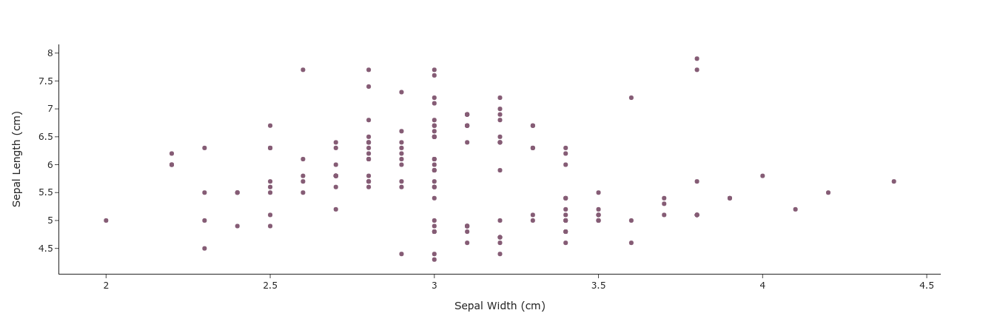

In [7]:
fig_iris_better = px.scatter(dta_iris, 
                             x="SepalWidth", 
                             y="SepalLength",
                             labels = {'SepalWidth':'Sepal Width (cm)', 
                                       'SepalLength':'Sepal Length (cm)'},
                             template = "simple_white", 
                             color_discrete_sequence=px.colors.qualitative.Antique
                            )

fig_iris_better.show()

Oh no! We forgot to add a title. We can use the function `update_layout` to add the title with the argument `title_text="Your Title"`. Update your previous figure with the title `"Relationship between Sepal Length and Sepal Width"` and show the plot.

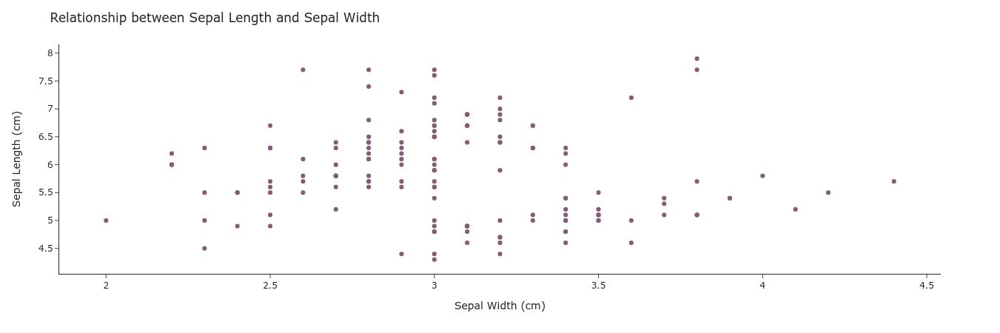

In [8]:
fig_iris_better.update_layout(title_text="Relationship between Sepal Length and Sepal Width")

fig_iris_better.show()

#### deeper evaluation of the pattern

We now want to evaluate the pattern further. 

This further evaluation may include:

- using color to find further patterns

`color = "YOUR_VARIABLE"`
- separating data by facets to find different patterns

`facet_col = "YOUR_VARIABLE"`
- adding a trendline from options `ols` or `lowess`

`facet_col = "ols"`
- changing the opacity to view concentration of observations with a value from (0,1)

`opacity = 0.4`

To update our example, use the settings in `fig_iris_better` and add the additional arguments to change opacity to 0.4, add a OLS trendline, and color and facet by `Species`. Call this new plot `fig_iris_deeper` and show the plot.

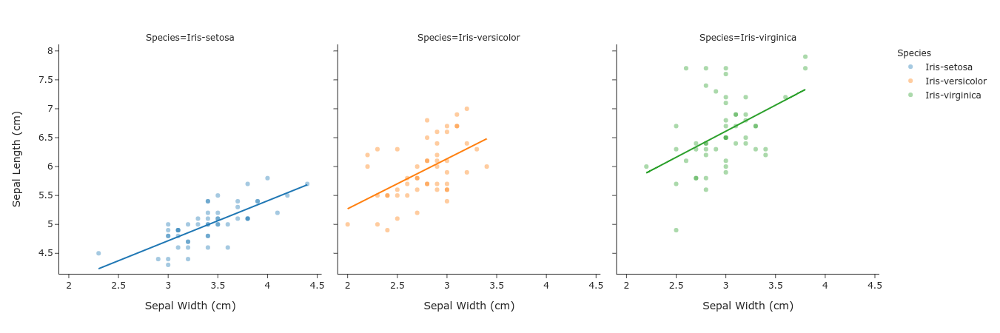

In [9]:
fig_iris_deeper = px.scatter(dta_iris, 
                             x="SepalWidth", 
                             y="SepalLength",
                             labels = {'SepalWidth':'Sepal Width (cm)', 
                                       'SepalLength':'Sepal Length (cm)'},
                             template = "simple_white",
                             opacity = 0.4,
                             color = "Species",
                             facet_col = "Species",
                             trendline="ols"
                            )
    
fig_iris_deeper.show()

Update the plot with the following code:

<blockquote><tt>
<pre>for a in fig_iris_deeper.layout.annotations: 
    a.text = a.text.split("=")[1] 

fig_iris_deeper.update_layout(showlegend=False)
    
fig_iris_deeper.show()</pre>
</tt></blockquote>

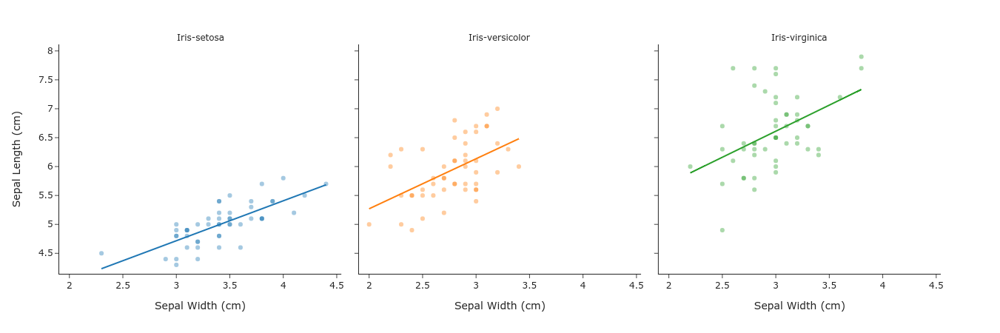

In [10]:
for a in fig_iris_deeper.layout.annotations:
    a.text = a.text.split("=")[1]

fig_iris_deeper.update_layout(showlegend=False)
    
fig_iris_deeper.show()

We have now achieved a informative scatter plot!

### Line Graphs

To start to evaluate data, we need data. The `Foreign_Exchange_Rates.csv` dataset contains 15 variables:

- `Time Serie`: the date the currency exchange rate was measured
- 14 currency exchange rates for 14 different countries

Import `pandas` as `pd`. Use the function `read_csv` in `pandas` to read in the `Foreign_Exchange_Rates.csv` dataset and name it `dta_EXCH`. 

__Note__: The variable names are found in the file and the file does not have an index.

In [11]:
import pandas as pd

dta_EXCH = pd.read_csv("datasets/Foreign_Exchange_Rates.csv")

Take a closer look at `dta_EXCH` by printing out the first 5 rows using the function `head`.

In [12]:
dta_EXCH.head(5)

,Time Serie,AUSTRALIA - AUSTRALIAN DOLLAR/US$,EURO AREA - EURO/US$,NEW ZEALAND - NEW ZELAND DOLLAR/US$,UNITED KINGDOM - UNITED KINGDOM POUND/US$,BRAZIL - REAL/US$,CANADA - CANADIAN DOLLAR/US$,CHINA - YUAN/US$,HONG KONG - HONG KONG DOLLAR/US$,INDIA - INDIAN RUPEE/US$,KOREA - WON/US$,MEXICO - MEXICAN PESO/US$,SOUTH AFRICA - RAND/US$,SINGAPORE - SINGAPORE DOLLAR/US$,DENMARK - DANISH KRONE/US$,JAPAN - YEN/US$,MALAYSIA - RINGGIT/US$,NORWAY - NORWEGIAN KRONE/US$,SWEDEN - KRONA/US$,SRI LANKA - SRI LANKAN RUPEE/US$,SWITZERLAND - FRANC/US$,TAIWAN - NEW TAIWAN DOLLAR/US$,THAILAND - BAHT/US$
0,1/3/00,1.5172,0.9847,1.9033,0.6146,1.8050,1.4465,8.2798,7.7765,43.55,1128.0,9.4015,6.126,1.6563,7.3290,101.70,3.8,7.964,8.4430,72.30,1.5808,31.38,36.97
1,1/4/00,1.5239,0.9700,1.9238,0.6109,1.8405,1.4518,8.2799,7.7775,43.55,1122.5,9.4570,6.085,1.6535,7.2180,103.09,3.8,7.934,8.3600,72.65,1.5565,30.60,37.13
2,1/5/00,1.5267,0.9676,1.9339,0.6092,1.8560,1.4518,8.2798,7.7780,43.55,1135.0,9.5350,6.070,1.6560,7.2080,103.77,3.8,7.935,8.3530,72.95,1.5526,30.80,37.10
3,1/6/00,1.5291,0.9686,1.9436,0.6070,1.8400,1.4571,8.2797,7.7785,43.55,1146.5,9.5670,6.080,1.6655,7.2125,105.19,3.8,7.940,8.3675,72.95,1.5540,31.75,37.62
4,1/7/00,1.5272,0.9714,1.9380,0.6104,1.8310,1.4505,8.2794,7.7783,43.55,1138.0,9.5200,6.057,1.6625,7.2285,105.17,3.8,7.966,8.4150,73.15,1.5623,30.85,37.30


This dataset may not be in the form we need. To do line graphs using `plotly`, it would be easier to transform this dataset from "wide" to "long" format. We are going to call this new "long" formatted dataset `dta_EXCH_L`.

This can be done with the with the following code:

<blockquote><tt>
<pre>dta_EXCH_L = pd.melt(dta_EXCH, id_vars='Time Serie',
                     var_name = "Currency", 
                     value_name = "Exchange Rate")
dta_EXCH_L['Currency'] = dta_EXCH_L['Currency'].str.split('/').str[0]
dta_EXCH_L['Country'] = dta_EXCH_L['Currency'].str.split(' - ').str[0]
dta_EXCH_L['Currency'] = dta_EXCH_L['Currency'].str.split(' - ').str[1]</pre>
</tt></blockquote>

In [13]:
dta_EXCH_L = pd.melt(dta_EXCH, id_vars='Time Serie',
                     var_name = "Currency", 
                     value_name = "Exchange Rate")
dta_EXCH_L['Currency'] = dta_EXCH_L['Currency'].str.split('/').str[0]
dta_EXCH_L['Country'] = dta_EXCH_L['Currency'].str.split(' - ').str[0]
dta_EXCH_L['Currency'] = dta_EXCH_L['Currency'].str.split(' - ').str[1]

Take a closer look at the "long" `dta_EXCH_L` by printing out the first 5 rows using the function `head`. Evaluate what has changed from the original imported data `dta_EXCH`. How was this done?

In [14]:
dta_EXCH_L.head(5)

,Time Serie,Currency,Exchange Rate,Country
0,1/3/00,AUSTRALIAN DOLLAR,1.5172,AUSTRALIA
1,1/4/00,AUSTRALIAN DOLLAR,1.5239,AUSTRALIA
2,1/5/00,AUSTRALIAN DOLLAR,1.5267,AUSTRALIA
3,1/6/00,AUSTRALIAN DOLLAR,1.5291,AUSTRALIA
4,1/7/00,AUSTRALIAN DOLLAR,1.5272,AUSTRALIA


Import `plotly.express` as `px` to use the `line` function.

In [15]:
import plotly.express as px

To understand the arguments for plotting a line graph, use the documentation in `plotly.express` for the `line` function: <a href="https://plotly.com/python-api-reference/generated/plotly.express.line.html" target="_top">here</a>. 

Produce a line graph of the dataset `dta_EXCH_L` where `Time Serie` is on the x-axis with label "Time", `Exchange Rate` is on the y-axis with label "Exchange Rate/US$", and the template is `simple_white`. Name this bar graph `fig_EXCH_0`. 

Hint: use the function `px.line`.

Use `fig_EXCH_0.show()` to display the plot.

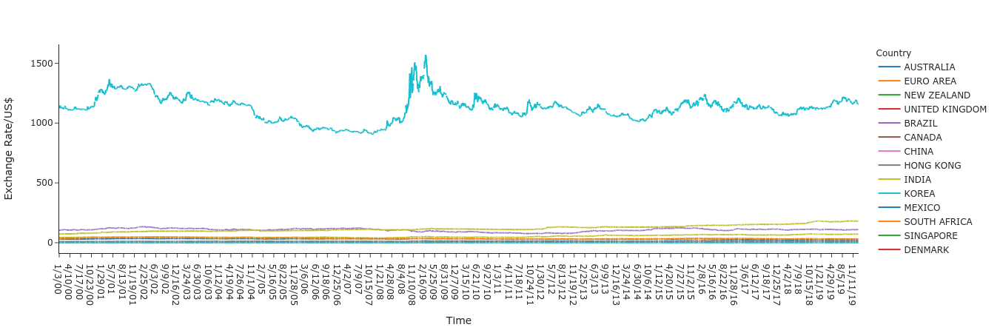

In [16]:
fig_EXCH_0 = px.line(dta_EXCH_L,
                     x="Time Serie", 
                     y="Exchange Rate", 
                     color="Country",
                     labels = {'Time Serie':'Time',
                               'Exchange Rate':'Exchange Rate/US$'},
                     template = "simple_white")

fig_EXCH_0.show()

Yikes! This graph is terrible to review. Using the interactive tools with `plotly` by hovering over the line, we can tell that the offending visual distribution is due to `KOREA`. 

Subset the data to exclude `KOREA`. Repeat the previous plot. Name the new plot `fig_EXCH_1`.

Use `fig_EXCH_1.show()` to display the plot. Did it improve?

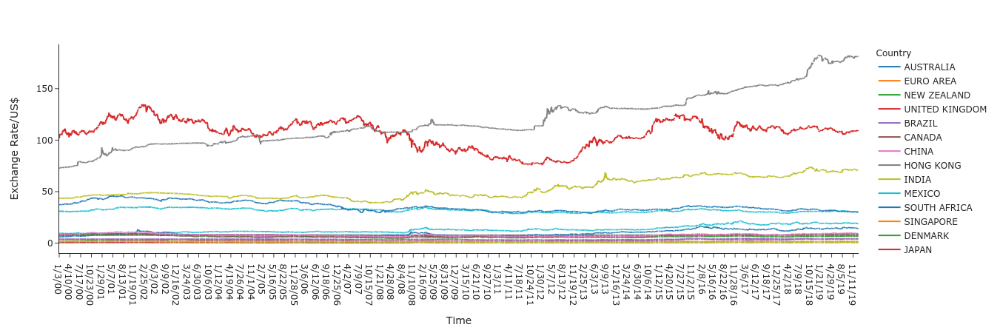

In [17]:
fig_EXCH_1 = px.line(dta_EXCH_L[dta_EXCH_L['Country'] != "KOREA"],
                     x="Time Serie", 
                     y="Exchange Rate", 
                     color="Country",
                     labels = {'Time Serie':'Time',
                               'Exchange Rate':'Exchange Rate/US$'},
                     template = "simple_white")

fig_EXCH_1.show()

While the graph has improved some, it is still difficult to read. Instead of including all the countries except `KOREA`, only include `EURO AREA`,`SWITZERLAND`,`CANADA`, and `AUSTRALIA`. 

Subset the data to include only these countries. Repeat the previous plot. Name the new plot `fig_EXCH_2`.

Use `fig_EXCH_2.show()` to display the plot. Did it improve?

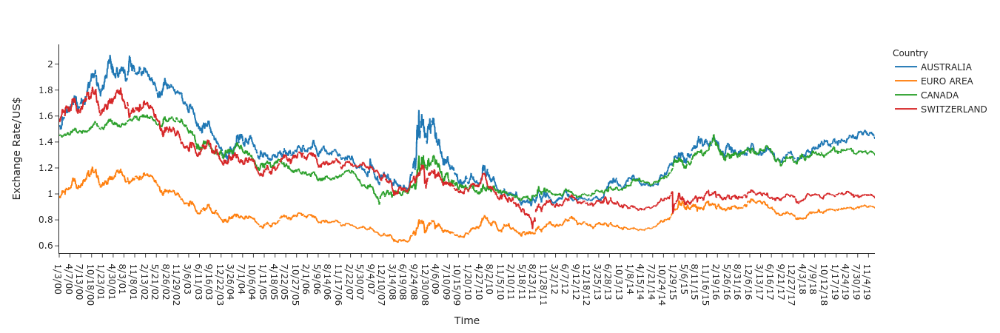

In [18]:
fig_EXCH_2 = px.line(dta_EXCH_L[dta_EXCH_L['Country'].isin(["EURO AREA","SWITZERLAND","CANADA","AUSTRALIA"])],
                     x="Time Serie", 
                     y="Exchange Rate", 
                     color="Country",
                     labels = {'Time Serie':'Time',
                               'Exchange Rate':'Exchange Rate/US$'},
                     template = "simple_white")

fig_EXCH_2.show()

We have now achieved a informative line plot!

### Bar Charts

To start to evaluate data, we need data. The `rank2020.csv` dataset contains 14 variables:

- `Score_Rank`: rank according to The Times Higher Education 
- `University`: name of the university
- `Country`: country of the university
- `Number_students`: number of students
- `Numb_students_per_Staff`: ratio between the number of students and the staff
- `International_Students`: percentage of international students
- `Percentage_Female`: percentage of women
- `Percentage_Male`: percentage of men
- `Teaching`: score in teaching
- `Research`: score in research
- `Citations`: score in citations
- `Industry_Income`: score in industry income
- `International_Outlook`: score in international outlook
- `Overall_Ranking`: resulting score, weighted by 30% teaching, 30% research, 30% citations, 7.5% international outlook, 2.5% industry income

Import `pandas` as `pd`. Use the function `read_csv` in `pandas` to read in the `rank2020.csv` dataset and name it `dta_rank`. 

__Note__: The variable names are found in the file and the file does not have an index.

In [19]:
import pandas as pd

dta_rank = pd.read_csv("datasets/rank2020.csv")

Take a closer look at `dta_rank` by printing out the first 5 rows using the function `head`.

In [20]:
dta_rank.head(5)

,Score_Rank,University,Country,Number_students,Numb_students_per_Staff,International_Students,Percentage_Female,Percentage_Male,Teaching,Research,Citations,Industry_Income,International_Outlook,Overall_Ranking
0,1,University of Oxford,United Kingdom,20664,11.2,41,46,54,90.5,99.6,98.4,65.5,96.4,95.4
1,2,California Institute of Technology,United States,2240,6.4,30,34,66,92.1,97.2,97.9,88.0,82.5,94.5
2,3,University of Cambridge,United Kingdom,18978,10.9,37,47,53,91.4,98.7,95.8,59.3,95.0,94.4
3,4,Stanford University,United States,16135,7.3,23,43,57,92.8,96.4,99.9,66.2,79.5,94.3
4,5,Massachusetts Institute of Technology,United States,11247,8.6,34,39,61,90.5,92.4,99.5,86.9,89.0,93.6


We would like to be able to evaluate the data by percent of international students and percent of female students. Based on feedback we have received we need to create an indicator for:

- percentage of international students into two category > 30\%; and,
- percentage of female students into two categorys > 40\%

Add these new variables to the dataset and name them `International_30` and `Female_40`, respectively.

Don't forget to rename the indicator levels "Yes" and "No".

__Hint:__ You may need the function `replace`. 

In [21]:
dta_rank['International_30'] = dta_rank.International_Students > 30
dta_rank.International_30 = dta_rank.International_30.replace({True: 'Yes', False: 'No'})
dta_rank['Female_40'] = dta_rank.Percentage_Female > 40
dta_rank.Female_40 = dta_rank.Female_40.replace({True: 'Yes', False: 'No'})

With further evaluation, it appears the universities can have the same ranking if they tie in score. This will not go over well with plotting. To overcome this, sort the dataset by `Score_Rank` and `Number_students` using the function `sort_values`. Then, add a new variable to the dataset named `Rank` based on the row index for our artifical rank based on the actual rank and the number of students.

In [22]:
dta_rank = dta_rank.sort_values(by=['Score_Rank', 'Number_students'])
dta_rank["Rank"] = dta_rank.index

Take a closer look at the updated dataset `dta_rank` by printing out the first 5 rows using the function `head`. 

In [23]:
dta_rank.head(5)

,Score_Rank,University,Country,Number_students,Numb_students_per_Staff,International_Students,Percentage_Female,Percentage_Male,Teaching,Research,Citations,Industry_Income,International_Outlook,Overall_Ranking,International_30,Female_40,Rank
0,1,University of Oxford,United Kingdom,20664,11.2,41,46,54,90.5,99.6,98.4,65.5,96.4,95.4,Yes,Yes,0
1,2,California Institute of Technology,United States,2240,6.4,30,34,66,92.1,97.2,97.9,88.0,82.5,94.5,No,No,1
2,3,University of Cambridge,United Kingdom,18978,10.9,37,47,53,91.4,98.7,95.8,59.3,95.0,94.4,Yes,Yes,2
3,4,Stanford University,United States,16135,7.3,23,43,57,92.8,96.4,99.9,66.2,79.5,94.3,No,Yes,3
4,5,Massachusetts Institute of Technology,United States,11247,8.6,34,39,61,90.5,92.4,99.5,86.9,89.0,93.6,Yes,No,4


Despite the dataset containing the Top 100 ranked universities, we are first interested in the Top 25 ranked universities based on their rank according to The Times Higher Education. Subset by `Score_Rank` and rename the resulting dataset `dta_rank_25`. 

In [24]:
dta_rank_25 = dta_rank[dta_rank.Score_Rank <= 25]

Import `plotly.express` as `px` to use the `bar` function.

In [25]:
import plotly.express as px

To understand the arguments for plotting a bar graph, use the documentation in `plotly.express` for the `bar` function: <a href="https://plotly.com/python-api-reference/generated/plotly.express.bar.html" target="_top">here</a>. 

Produce a bar graph of the dataset `dta_rank_25` where `Rank` is on the x-axis with label "Rank", `Number_students` is on the y-axis with label "Number of Students", the `hover_data` displayed includes `Score_Rank`, `University`, `Country`, and `Number_students`, and the template is `simple_white`. Name this bar graph `fig_rank1`. 

Hint: use the function `px.bar`.

Before displaying the data, run the code below to update the axis ticks from our artifical ranks in `Rank` to the true ranks from `Score_Rank`.

<blockquote><tt>
<pre>fig_rank1.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25"
)</pre>
</tt></blockquote>

Use `fig_rank1.show()` to display the plot.

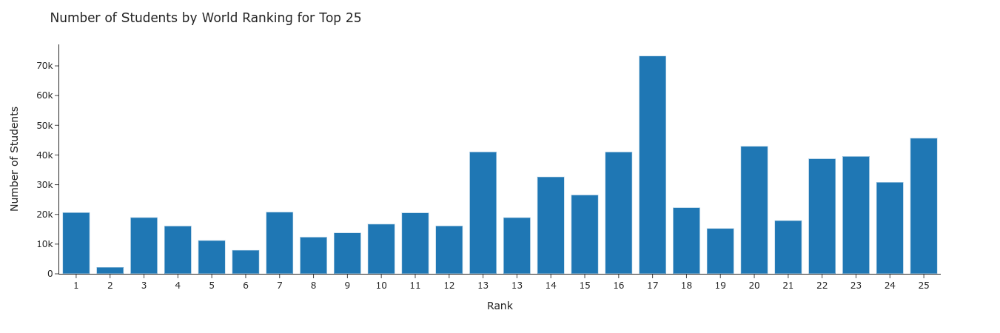

In [26]:
fig_rank1 = px.bar(dta_rank_25, 
                   x="Rank", 
                   y="Number_students",
                   hover_data=['Score_Rank',"University","Country",
                               "Number_students"],
                   labels={"Rank":"Rank", 
                           "Number_students":"Number of Students"},
                   template = "simple_white")

fig_rank1.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25"
)

fig_rank1.show()

This plot is nice, but we would really like to evaluate the patterns for universities with at least 40\% females.

Use the same set up as the previous plot `fig_rank1`, except include the argument for `color` to color the plot by `Female_40`. Make sure the label is updated for this variable to read: "Female Students > 40%". Update the `hover_data` to also include: `Percentage_Female`. Name this plot `fig_rank2`.

Before displaying the data, again run the code below to update the axis ticks from our artifical ranks in `Rank` to the true ranks from `Score_Rank` and change the position of the legend for better viewing.

<blockquote><tt>
<pre>fig_rank2.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25",
    legend_orientation="h",
    legend=dict(x=0, y=1.06)
)</pre>
</tt></blockquote>

Use `fig_rank2.show()` to display the plot.

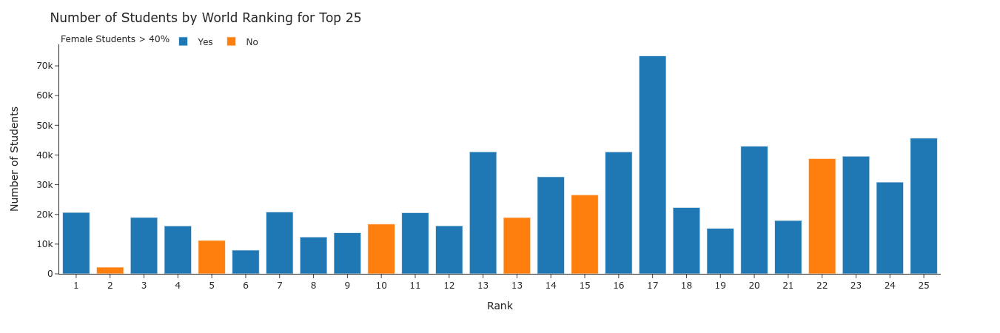

In [27]:
fig_rank2 = px.bar(dta_rank_25, x="Rank", y="Number_students", 
                 hover_data=['Score_Rank',"University","Country",
                            "Number_students","Percentage_Female"],
                   color="Female_40",
                 labels={"Rank":"Rank", 
                         "Female_40":"Female Students > 40%",
                         "Number_students":"Number of Students"},
                     template = "simple_white")

fig_rank2.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25",
    legend_orientation="h",
    legend=dict(x=0, y=1.06)
)

fig_rank2.show()

Use the same set up as the previous plot `fig_rank2`, except include the argument for `color` to color the plot by `International_30`. Make sure the label is updated for this variable to read: "International Students > 30%". Update the color scheme by using the argument `color_discrete_sequence=px.colors.qualitative.Antique` to avoid confusion. Update the `hover_data` to also include: `International_Students`. Name this plot `fig_rank3`.

Before displaying the data, again run the code below to update the axis ticks from our artifical ranks in `Rank` to the true ranks from `Score_Rank` and change the position of the legend for better viewing.

<blockquote><tt>
<pre>fig_rank3.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25",
    legend_orientation="h",
    legend=dict(x=0, y=1.06)
)</pre>
</tt></blockquote>

Use `fig_rank3.show()` to display the plot.

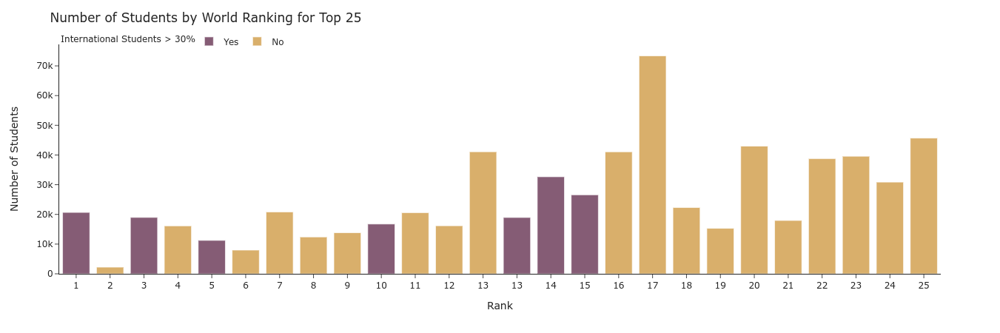

In [28]:
fig_rank3 = px.bar(dta_rank_25, x="Rank", y="Number_students", 
                 hover_data=['Score_Rank',"University","Country",
                            "Number_students","International_Students"],
                   color="International_30",
                   color_discrete_sequence=px.colors.qualitative.Antique,
                 labels={"Rank":"Rank", 
                         "International_30":"International Students > 30%",
                         "Number_students":"Number of Students"},
                     template = "simple_white")

fig_rank3.update_layout(
    xaxis = dict(
        tickvals = list(range(0, 26)),
        ticktext = dta_rank_25.Score_Rank.values
    ),
    title="Number of Students by World Ranking for Top 25",
    legend_orientation="h",
    legend=dict(x=0, y=1.06)
)

fig_rank3.show()

We are now able to use bar plots to evaluate relationships! 

### Box Plots

To start to evaluate data, we need data. The `tv_shows.csv` dataset contains 10 variables:

- `Title`: the TV show title
- `Year`: the year the TV show started
- `Age`: the age of the intended audience
- `IMDb`: the IMDb ranking
- `Rotten Tomatoes`: the Rotten Tomatoes ranking
- `Netflix`: 1=available on Netflix, 0=otherwise
- `Hulu`: 1=available on Hulu, 0=otherwise

Import `pandas` as `pd`. Use the function `read_csv` in `pandas` to read in the `tv_shows.csv` dataset and name it `dta_tv`. 

__Note__: The variable names are not found in the file and the file does not have an index.

In [29]:
import pandas as pd

dta_tv = pd.read_csv("datasets/tv_shows.csv")

Take a closer look at `dta_tv` by printing out the first 5 rows using the function `head`.

In [30]:
dta_tv.head(5)

,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu
0,Breaking Bad,2008,18+,9.5,96,1,0
1,Stranger Things,2016,16+,8.8,93,1,0
2,Money Heist,2017,18+,8.4,91,1,0
3,Sherlock,2010,16+,9.1,78,1,0
4,Better Call Saul,2015,18+,8.7,97,1,0


We would really like the years to actually be accumulated into decades. Using the variable `Year`, calculate the decade the TV show started and name this variable `decade`. Use the calculated decade to add a variable to the dataset called `Decade`. 

In [31]:
import numpy as np
decades = np.floor(dta_tv["Year"] / 10) * 10
dta_tv["Decade"] = decades.values

We would also like to update the levels for the `Netflix` and `Hulu` variables. Rename the indicator levels "Yes" and "No".

__Hint:__ You may need the function `replace`. 

In [32]:
dta_tv["Netflix"] = dta_tv["Netflix"].replace({1: 'Yes', 0: 'No'})
dta_tv["Hulu"] = dta_tv["Hulu"].replace({1: 'Yes', 0: 'No'})

Take a closer look at the updated dataset `dta_tv` by printing out the first 5 rows using the function `head`. 

In [33]:
dta_tv.head(5)

,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Decade
0,Breaking Bad,2008,18+,9.5,96,Yes,No,2000.0
1,Stranger Things,2016,16+,8.8,93,Yes,No,2010.0
2,Money Heist,2017,18+,8.4,91,Yes,No,2010.0
3,Sherlock,2010,16+,9.1,78,Yes,No,2010.0
4,Better Call Saul,2015,18+,8.7,97,Yes,No,2010.0


Import `plotly.express` as `px` to use the `box` function.

In [34]:
import plotly.express as px

To understand the arguments for plotting a box plot, use the documentation in `plotly.express` for the `box` function: <a href="https://plotly.github.io/plotly.py-docs/generated/plotly.express.box.html" target="_top">here</a>. 

Produce a box plot of the dataset `dta_tv` for the variable `Rotten Tomatoes` (on the y-axis) using the template `simple_white`. Name this bar graph `fig_tv1`. 

Hint: use the function `px.box`.

Use `fig_tv1.show()` to display the plot.

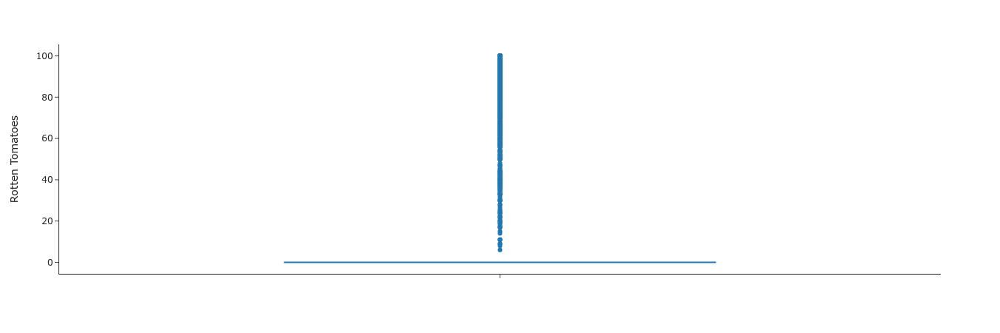

In [35]:
fig_tv1 = px.box(dta_tv, y="Rotten Tomatoes",
                     template = "simple_white")

fig_tv1.show()

This plot shows an informative distribution of the Rotton Tomatoe scores by providing the median and range in the traditional boxplot. Since the box plot is for all the data, it is difficult to see any patterns.

Use the same set up as the previous plot `fig_tv1`, except include an x-axis variable Name this plot `fig_tv2`.

Use `fig_tv2.show()` to display the plot.

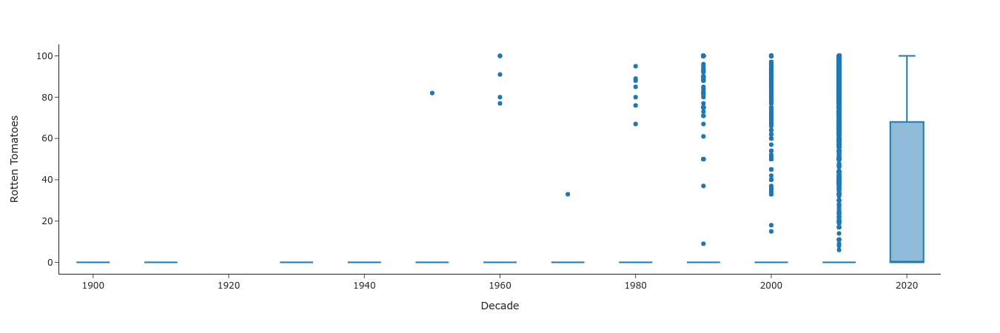

In [36]:
fig_tv2 = px.box(dta_tv, x="Decade", y="Rotten Tomatoes",
                     template = "simple_white")

fig_tv2.show()

We are improving! The data will be most meaningful if we can also look at the patterns when the TV shows are available on Hulu and Netflix. This evaluation only really makes sense if the year is at least 2000.

Subset the data `dta_tv` to include only rows only at least 2000 `dta_tv.Year >= 2000`. Use the same set up as the previous plot `fig_tv2`, except include arguments to color the box plots by `Hulu` status and facet the box plots (in columns) by `Netflix` status. Name this plot `fig_tv3`. 

Use `fig_tv3.show()` to display the plot.

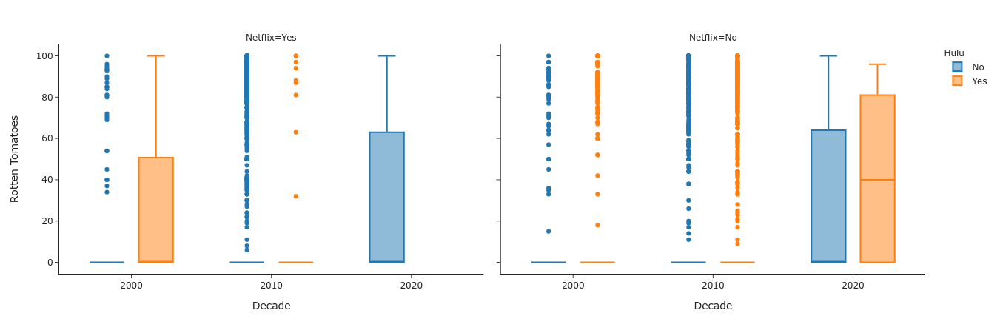

In [37]:
fig_tv3 = px.box(dta_tv[dta_tv.Year >= 2000], 
                x="Decade", 
                y="Rotten Tomatoes", 
                color="Hulu",
                facet_col="Netflix",
                template = "simple_white"
               )

fig_tv3.show()

We are now able to use box plots to evaluate relationships! 

### Plots of Distributions: Histograms and Density plots

To start to evaluate data, we need data. The `tips` dataset contains 7 variables:

- `total_bill`: the total bill amount
- `tip`: the tip amount
- `sex`: the sex of the waiter
- `smoker`: the smoking status of the customer
- `day`: the day of the week
- `time`: the time of day
- `size`: the size of the the customer party 

Import `plotly.express` as `px` and `plotly.figure_factory` as `ff`. `plotly.express` allows us to use the `histogram` function and built-in datasets. `plotly.figure_factory` allows us to use the `create_distplot` function. 

In [38]:
import plotly.express as px
import plotly.figure_factory as ff

Read in the built-in dataset `tips` with `px.data.tips()` and name it `df_tips`. 

In [39]:
df_tips = px.data.tips()

Take a closer look at `df_tips` by printing out the first 5 rows using the function `head`.

In [40]:
df_tips.head(5)

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


We should really have variable that adjusts the tip amount for the total bill. Calculate the ratio of `tip` to `total` bill and add it as a variable called `ratio` to the dataset `df_tips`.

In [41]:
df_tips["ratio"] = df_tips["tip"]/df_tips["total_bill"]

Take a closer look at the updated dataset `df_tips` by printing out the first 5 rows using the function `head`. 

In [42]:
df_tips.head(5)

,total_bill,tip,sex,smoker,day,time,size,ratio
0,16.99,1.01,Female,No,Sun,Dinner,2,0.059447
1,10.34,1.66,Male,No,Sun,Dinner,3,0.160542
2,21.01,3.50,Male,No,Sun,Dinner,3,0.166587
3,23.68,3.31,Male,No,Sun,Dinner,2,0.139780
4,24.59,3.61,Female,No,Sun,Dinner,4,0.146808


#### Histograms

To understand the arguments for plotting a histogram, use the documentation in `plotly.express` for the `histogram` function: <a href="https://plotly.github.io/plotly.py-docs/generated/plotly.express.histogram.html" target="_top">here</a>. 

Produce a histogram of the dataset `df_tips` for the variable `total_bill` (on the x-axis) labeled "Total Bill" using the template `simple_white`. Name this bar graph `fig_hist_tips1`. 

Hint: use the function `px.histogram`.

Use `fig_hist_tips1.show()` to display the plot.

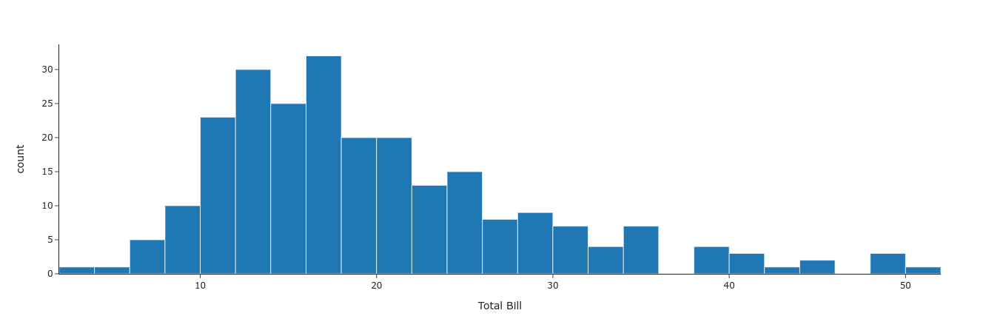

In [43]:
fig_hist_tips1 = px.histogram(df_tips, 
                              x="total_bill",
                              labels={"total_bill":"Total Bill"},
                              template = "simple_white")
fig_hist_tips1.show()

We would really like to know if the ratio of the tip to the total bill is different for males and females. To comprehensively evaluate the difference, we can compare their distributions. 

Produce a histogram of the dataset `df_tips` for the variable `ratio` (on the x-axis) labeled "Ratio of Tip to Total Bill Amount" using the template `simple_white`, color by `sex`, and add a marginal violin plot. Name this bar graph `fig_hist_tips2`. 

Use `fig_hist_tips2.show()` to display the plot.

Is there a difference in distribution between males and females?

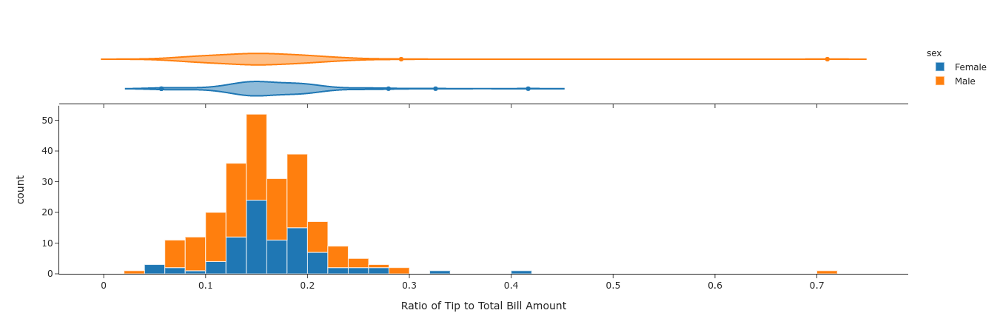

In [44]:
fig_hist_tips2 = px.histogram(df_tips, 
                   x="ratio",
                  labels={"ratio":"Ratio of Tip to Total Bill Amount"},
                         color="sex",
                         marginal="violin",
                template = "simple_white")
fig_hist_tips2.show()

No! The distributions look similar in shape and center. 

#### Density Plots

To understand the arguments for plotting a density plot, use the documentation in `plotly.express` for the `create_distplot` function: <a href="https://plotly.github.io/plotly.py-docs/generated/plotly.figure_factory.create_distplot.html" target="_top">here</a>. These plots are soon to be depreciated, but are currently the simplist way to display a density curve to evaluate distribution.

We want to produce a density plot of the dataset `df_tips` for the variable `total_bill`. Use the following code to create and display the plot:

<blockquote><tt>
<pre>tempdata1 = [df_tips.total_bill.values]
name1 = ['All']
fig_dist_tips1 = ff.create_distplot(tempdata1,name1)
fig_dist_tips1.update_layout(showlegend=False)
fig_dist_tips1.show()</pre>
</tt></blockquote>

Carefully evaluate to understand what each of the three lines is doing!

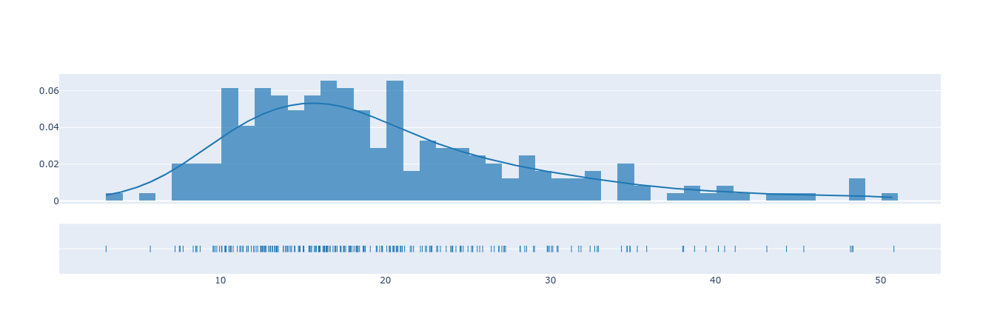

In [45]:
tempdata1 = [df_tips.total_bill.values]
name1 = ['All']
fig_dist_tips1 = ff.create_distplot(tempdata1,name1)
fig_dist_tips1.update_layout(showlegend=False)
fig_dist_tips1.show()

We want to produce a density plot of the dataset `df_tips` for the variable `ratio` for the different `time` values. Use the following code to create and display the plot:

<blockquote><tt>
<pre>dval = df_tips[df_tips.time == "Dinner"].ratio.values
lval = df_tips[df_tips.time == "Lunch"].ratio.values
tempdata2 = [dval, lval]
names2 = ["Dinner",'Lunch']
fig_dist_tips2 = ff.create_distplot(tempdata2, names2,
                                    colors=['gray', 
                                            'magenta'],
                                    show_hist=False,
                                    show_rug=False)

fig_dist_tips2.show()</pre>
</tt></blockquote>

Carefully evaluate to understand what each of the lines is doing!

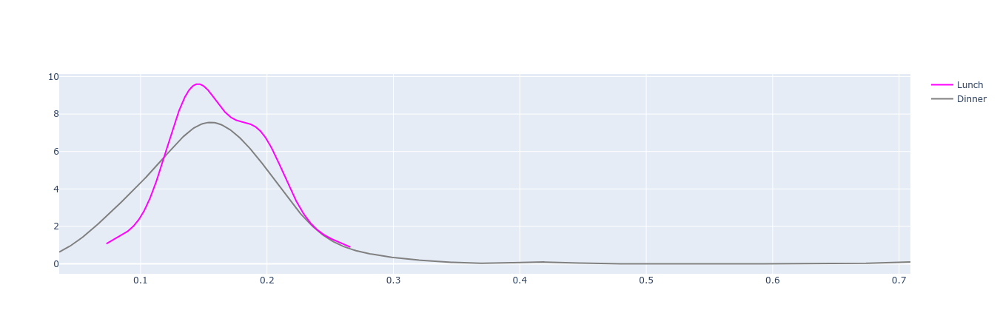

In [46]:
dval = df_tips[df_tips.time == "Dinner"].ratio.values
lval = df_tips[df_tips.time == "Lunch"].ratio.values
tempdata2 = [dval, lval]
names2 = ["Dinner",'Lunch']
fig_dist_tips2 = ff.create_distplot(tempdata2, names2,
                                    colors=['gray', 
                                            'magenta'],
                                    show_hist=False,
                                    show_rug=False)

fig_dist_tips2.show()

We have made it through plots of distribution!

### Other Plots

There are many other plots that are avaialable in `plotly`. There are also additional features not discussed here. Take a look at the `plotly` documentation for `python` found <a href="https://plotly.com/python/plotly-fundamentals/" target="_top">here</a>. Specifically, review the "Fundamentals", the "Basic Charts", and the "Statistical Charts".

### Data Transformation

Sometimes data needs to be transformed. A data transformation can mean a few things. The data may need to be:

- cleaned/manipulated
- standardized
- normalized
- to have a stabilizing transformation performed for a specific variable (such as $\log$) 

The first three "data transformations" will be discussed in a later module. To perform a stabilizing transformation to be used in plotting, the data can either:

1. be transformed and added as a new variable to the data frame
2. be transformed directly inside the `plotly` function in `python`

Option (1) may be necessary if you need a transformation other than a $\log$ transformation or if you intend to use it for further data analysis beyond plotting.

Option (2) is the quick and dirty way to $\log$ transform the data for data visualization. 

To start to evaluate data, we need data. The `https://raw.githubusercontent.com/plotly/datasets/master/gapminderDataFiveYear.csv` dataset contains 6 variables:

- `country`: country 
- `year`: year
- `pop`: population size
- `continent`: continent
- `lifeExp`: average life expetency
- `gdpPercap`: GDP per capita

Import `pandas` as `pd`. Use the function `read_csv` in `pandas` to read in the `https://raw.githubusercontent.com/plotly/datasets/master/gapminderDataFiveYear.csv` dataset and name it `dta_gapminder`. 

__Note__: The variable names are found in the file and the file does not have an index.

In [47]:
import pandas as pd

dta_gapminder = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/gapminderDataFiveYear.csv")

To avoid further adjustment, we are only interested in looking at one snapshot in time. Let us select 1962. Subset the data for year 1962. Name this dataset `dta_gapminder_1962`.

In [48]:
dta_gapminder_1962 = dta_gapminder[dta_gapminder.year == 1962]

Take a closer look at `dta_gapminder_1962` by printing out the first 5 rows using the function `head`.

In [49]:
dta_gapminder_1962.head(5)

,country,year,pop,continent,lifeExp,gdpPercap
2,Afghanistan,1962,10267083.0,Asia,31.997,853.100710
14,Albania,1962,1728137.0,Europe,64.820,2312.888958
26,Algeria,1962,11000948.0,Africa,48.303,2550.816880
38,Angola,1962,4826015.0,Africa,34.000,4269.276742
50,Argentina,1962,21283783.0,Americas,65.142,7133.166023


With what you have learned about scatterplots, make a scatterplot of `dta_gapminder_1962` with `gdpPercap` on the x-axis labeled "GDP per capita", `lifeExp` on the y-axis labeled "Average Life Expectancy". Name the plot `fig_gap_1962` and show the plot using `fig_gap_1962.show()`.

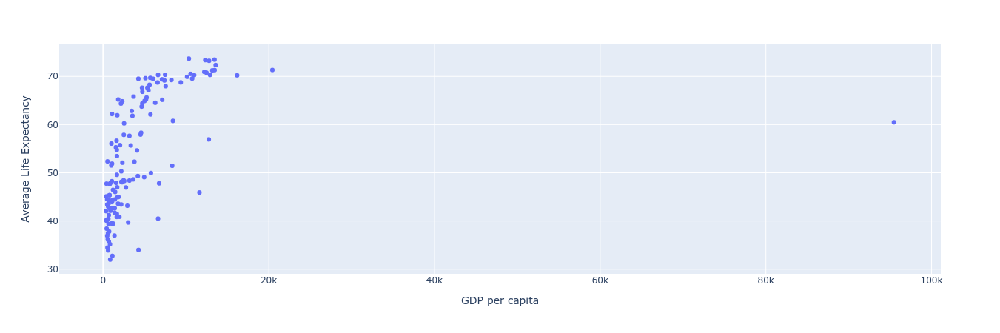

In [50]:
fig_gap_1962 = px.scatter(dta_gapminder_1962,
                          x="gdpPercap", y="lifeExp",
                          labels={"gdpPercap":"GDP per capita",
                                  "lifeExp":"Average Life Expectancy"})

fig_gap_1962.show()

This plot is not easy to read. Let us attempt a log transformation of the GDP per capita.

Using the same framework from the previous plot, add the argument `log_x=True`. Name the plot `fig_gap_1962_log` and show the plot using `fig_gap_1962_log.show()`.

Repeat the same plot, except use the arguments `log_x=True` and `log_y=True` for display the axis as log-scaled. Name this plot `fig_iris_log`.

Before displaying the data, add the code for better viewing.

<blockquote><tt>
<pre>for a in fig_gap_1962_log.layout.annotations:
    a.text = a.text.split("=")[1]
    
import plotly.graph_objs as go

for axis in fig_gap_1962_log.layout:
    if type(fig_gap_1962_log.layout[axis]) == go.layout.YAxis:
        fig_gap_1962_log.layout[axis].title.text = ''

fig_gap_1962_log.update_layout(showlegend=False,
                              annotations = list(fig_gap_1962_log.layout.annotations) + 
    [go.layout.Annotation(
            x=-0.17,
            y=0.5,
            font=dict(
                size=14
            ),
            showarrow=False,
            text="Average Life Expectancy",
            textangle=-90,
            xref="paper",
            yref="paper"
        )
    ])
</pre>
</tt></blockquote>

Show plot using `fig_gap_1962_log.show()`.

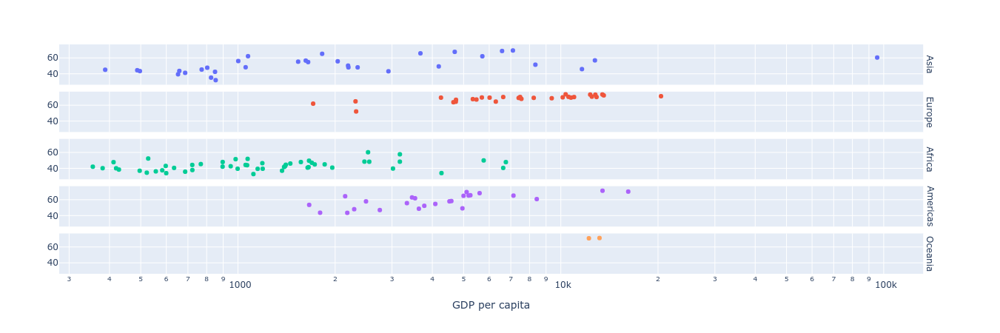

In [51]:
fig_gap_1962_log = px.scatter(dta_gapminder_1962,
                              x="gdpPercap", y="lifeExp",
                              facet_row="continent",
                              color="continent",
                              facet_col_wrap = 2,
                              log_x=True,
                              labels={"gdpPercap":"GDP per capita"})

for a in fig_gap_1962_log.layout.annotations:
    a.text = a.text.split("=")[1]
    
import plotly.graph_objs as go

for axis in fig_gap_1962_log.layout:
    if type(fig_gap_1962_log.layout[axis]) == go.layout.YAxis:
        fig_gap_1962_log.layout[axis].title.text = ''

fig_gap_1962_log.update_layout(showlegend=False,
                              annotations = list(fig_gap_1962_log.layout.annotations) + 
    [go.layout.Annotation(
            x=-0.17,
            y=0.5,
            font=dict(
                size=14
            ),
            showarrow=False,
            text="Average Life Expectancy",
            textangle=-90,
            xref="paper",
            yref="paper"
        )
    ])

fig_gap_1962_log.show()

With this transformation, the data is stabilized and ready for further visualization or analysis.

### A normal vs. not normal distribution

The biggest assumption many methods make is that data is normally distibuted. How do we tell? 

There are some statistical tests that can be performed to evaluate normality:

- Shapiro-Wilk Test
- Kolmogorov-Smirnov Test
- D'Agostino's $K^2$ Test
- Anderson-Darling Test

Often it is easier to use plotting to quickly check:

- histogram 
- quantile-quantile plot

A _quantile-quantile plot_ or __qqplot__ is a plot of observed quantiles (on the x-axis) vs expected quantiles given follows the hypothesized distribution (on the y-axis) of the data.

After you have produced the __qqplot__, the interpretation is key. 

In an ideal setting, all of the quantiles will lie on or close to a straight line at a 45 degree angle from the x-axis like the plot below. If you have this, it indicates the two samples have a similar distribution.

<img src="https://media.geeksforgeeks.org/wp-content/uploads/20191021174307/qq1-300x272.jpg" alt="img1"
	title="" width="300" height="300" />

In practice, your __qqplot__ will not look like the plot above. Instead, a plot with similar distibutions will looks like the plot before: nearly on the line similarly distributed.

<img src="https://media.geeksforgeeks.org/wp-content/uploads/20191021174936/qq2.jpg" alt="img1"
	title="" width="300" height="300" />

#### QQ-plot Example

Import `plotly.graph_objects` as `go` and import `numpy` as `np`. You will need them!

In [210]:
import plotly.graph_objects as go
import numpy as np

Create a qqplot for `gdpPercap`.

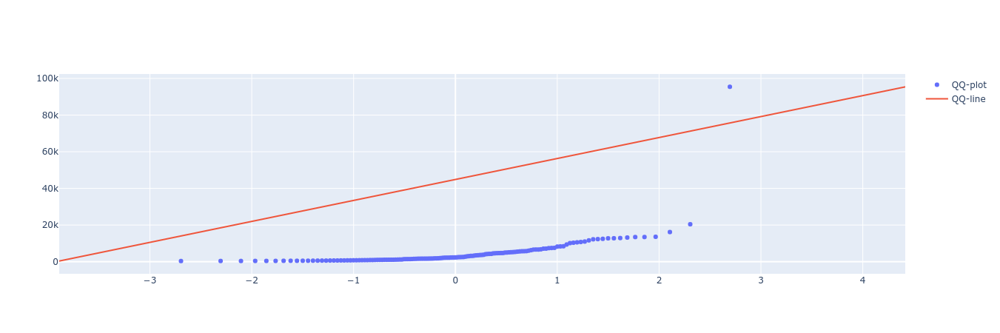

In [184]:
x = dta_gapminder_1962_sort["gdpPercap"]
r = x.rank()
n = len(x)
p = (r - 1/2) / n
y = norm.ppf(p, loc=0, scale=1)
              
a = [np.quantile(x, 0.00005),np.quantile(x, 0.999995)]        
b = [norm.ppf(0.00005, loc=0, scale=1),norm.ppf(0.999995, loc=0, scale=1)]


# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=y, y=x,
                         mode='markers', 
                         name='QQ-plot'))
fig.add_trace(go.Scatter(x=b, y=a,
                    mode='lines',
                    name='QQ-line'))

fig.show()

Create a qqplot for the log transformed `gdpPercap` called `gdpPercap_log`.

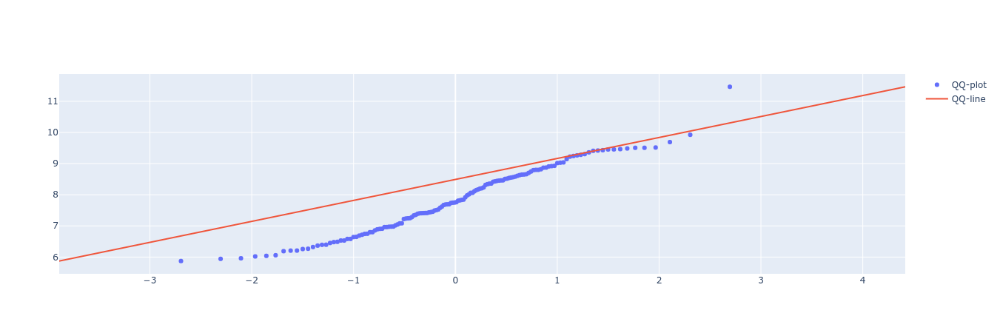

In [209]:
dta_gapminder_1962_sort['gdpPercap_log'] = np.log(dta_gapminder_1962_sort["gdpPercap"].values)
x = dta_gapminder_1962_sort["gdpPercap"]
n = len(x)

x1 = dta_gapminder_1962_sort["gdpPercap_log"]
r = x1.rank()
p = (r - 1/2) / n
y = norm.ppf(p, loc=0, scale=1)
              
a = [np.quantile(x1, 0.00005),np.quantile(x1, 0.999995)]        
b = [norm.ppf(0.00005, loc=0, scale=1),norm.ppf(0.999995, loc=0, scale=1)]


# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=y, y=x1,
                         mode='markers', 
                         name='QQ-plot'))
fig.add_trace(go.Scatter(x=b, y=a,
                    mode='lines',
                    name='QQ-line'))

fig.show()

### Misleading Graphs

Good data visualizations are extremely powerful tools for displaying large quantities of complex data for finding patterns. Unfortunately, it is common for some graphs to deceive or mislead. This may happen because the designer chooses to give readers the impression of better performance or results than is actually the situation. In other cases, the person who prepares the graph may want to be accurate and honest, but may mislead the reader by a poor choice of a graph form or poor graph construction.

The following things are important to consider when looking at a graph:
1. Title
2. Labels on both axes of a line or bar chart and on all sections of a pie chart 
3. Source of the data
4. Key to a pictograph
5. Uniform size of a symbol in a pictograph
6. Scale: Does it start with zero? If not, is there a break shown
7. Scale: Are the numbers equally spaced?

__Example 1__

They can be misleading because of the scale of the axes. For example, see the plot below showing drastic difference between "Now" and 1/1/2013 in top tax rates despite the actual rates at 35% and 39.6%. 

<img src="https://www.statisticshowto.com/wp-content/uploads/2014/01/Bush_cuts2.png" alt="img1"
	title="" width="500" height="500" />

ref: https://twitter.com/DanaDanger/status/230851016344600576/photo/1/large

__Example 2__ 

They can be misleading because the denominator is hidden. For example, see the plot below showing the very large rates of __common injuries children suffer__. This would lead you to believe that sinal, lower arm, upper arm, lower leg, and thighbone injuries are common. But, in smaller print, we see that the denominator is not all children and the metric reported is actually the number of injuries of children who are hospitalized.

<img src="https://www.statisticshowto.com/wp-content/uploads/2014/01/usa-today-1.png" alt="img1"
	title="" width="500" height="500" />

For practice on evaluating good vs. misleading graphs, use the worksheet (with solutions) found 
<a href="https://faculty.atu.edu/mfinan/2043/section31.pdf" target="_top">here</a>. 
